# XFactors

### Import

In [1]:
%load_ext autoreload
%autoreload 2

import os
PROJECT_PATH = "/projects/compures/alexandre/disdiff_adapters"
os.chdir(PROJECT_PATH)
print(os.getcwd())

import torch.nn as nn # type: ignore
from torch.utils.data import DataLoader, TensorDataset
import torchvision.utils as vutils

from PIL import Image, ImageDraw, ImageFont
from matplotlib.colors import ListedColormap, BoundaryNorm
from glob import glob

#DataModule
from disdiff_adapters.data_module import *
#Dataset
from disdiff_adapters.dataset import *
#Module
from disdiff_adapters.arch.vae import *
from disdiff_adapters.arch.multi_distillme import *
from disdiff_adapters.arch.classifier import *
#utils
from disdiff_adapters.utils import *
#loss   
from disdiff_adapters.loss import *
#metric
from disdiff_adapters.metric import *

from lightning.pytorch.callbacks import LearningRateMonitor, ModelCheckpoint
from lightning.pytorch.loggers import TensorBoardLogger
from lightning import Trainer
from lightning.pytorch.strategies import DDPStrategy

from disdiff_adapters.arch.multi_distillme import Xfactors
BATCH_SIZE = 32
LATENT_DIM = 2

torch.set_float32_matmul_precision('medium')

/import/pr_compures/alexandre/disdiff_adapters


/projects/compures/alexandre/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Load data 

**Choose the appropriate set :**

### 3DShapes

In [8]:
#6mn30 from ens cluster
shapes = Shapes3DDataModule(batch_size=32)
shapes.prepare_data()
shapes.setup(stage='fit')
shapes_loader = shapes.train_dataloader()

load dataset - train
load dataset val
tensors loaded.


In [9]:
print(len(shapes.train_dataset))

307200


In [10]:
for batch in shapes_loader :
    images, labels = batch
    print(labels.shape)
    break

torch.Size([32, 6])


### CelebA

In [2]:
celeba = CelebADataModule(batch_size=BATCH_SIZE)
celeba.prepare_data()
celeba.setup("fit")
celeba_loader = celeba.train_dataloader()
celeba_val_loader = celeba.val_dataloader()

In [3]:
len(celeba.train_dataset)

162770

### MNIST

In [ ]:
mnist = MNISTDataModule(batch_size=BATCH_SIZE)
mnist.prepare_data()
mnist.setup("fit")
mnist_loader = mnist.train_dataloader()

100%|██████████| 9.91M/9.91M [00:01<00:00, 5.58MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 383kB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 3.07MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 2.40MB/s]


### DSprites

In [ ]:
dsprites = DSpritesDataModule(batch_size=BATCH_SIZE)
dsprites.prepare_data()
dsprites.setup(stage='fit')
dsprites_loader = dsprites.train_dataloader()

load dataset - train
load dataset val
tensors loaded.


### Cars3D

In [6]:
cars3d = Cars3DDataModule(batch_size=BATCH_SIZE)
cars3d.prepare_data()
cars3d.setup(stage='fit')
cars3d_loader = cars3d.train_dataloader()
cars3d_val_loader = cars3d.val_dataloader()

load dataset - train
load dataset val
tensors loaded.


### Choose the correct loader

In [4]:
loader = celeba_loader
val_loader = celeba_val_loader
stop_at = 0

for i,batch in enumerate(loader) :
    images, labels = batch
    in_channels = images.shape[1]
    img_size = images.shape[2]
    if i == stop_at : break
    
print(f"Data selected with in_channels={in_channels} and img_size={img_size}")
toy_loader = DataLoader(TensorDataset(images, labels), batch_size=BATCH_SIZE)

Data selected with in_channels=3 and img_size=64


## Xfactors

In [5]:
select_factors=[15]
w=len(select_factors)
xfactor = Xfactors(in_channels=3, 
                   img_size=64, 
                   latent_dim_s=126, 
                   select_factors=select_factors, 
                   dims_by_factors=len(select_factors)*[2], 
                   l_nce_by_factors=len(select_factors)*[w*1e-1],
                   beta_s=100.0,
                   map_idx_labels=CelebA.Params.FACTORS_IN_ORDER,
                   factor_value=1,
                   binary_factor=True)
trainer = Trainer(gradient_clip_val= 3.0,
                  max_epochs=1,
                  log_every_n_steps=7,)

Trainer will use only 1 of 3 GPUs because it is running inside an interactive / notebook environment. You may try to set `Trainer(devices=3)` but please note that multi-GPU inside interactive / notebook environments is considered experimental and unstable. Your mileage may vary.
Using default `ModelCheckpoint`. Consider installing `litmodels` package to enable `LitModelCheckpoint` for automatic upload to the Lightning model registry.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2]

  | Name         | Type              | Params | Mode 
-----------------------------------------------------------
0 | model        | _MultiDistillMe   | 7.1 M  | train
1 | constrastive | InfoNCESupervised | 0      | train
-----------------------------------------------------------
7.1 M     Trainable params
0         Non-trainable params
7.1 M     Total params
28.572    Total estimated model params size (MB)
87        Modules in train mode
0         Modules in eval mode


Sanity Checking DataLoader 0:   0%|          | 0/2 [00:00<?, ?it/s]

Val loss: 0.19267933070659637
Epoch 0: 100%|██████████| 5087/5087 [03:03<00:00, 27.78it/s, v_num=88]     Val loss: 0.022878320887684822
Val loss: 0.019528431817889214
Val loss: 0.01999528892338276
Val loss: 0.017383664846420288
Val loss: 0.03931765258312225
Val loss: 0.05209105461835861
Val loss: 0.014491910114884377
Val loss: 0.01683155447244644
Val loss: 0.028086256235837936
Val loss: 0.018214590847492218
Val loss: 0.036443982273340225
Val loss: 0.019765108823776245
Val loss: 0.024623239412903786
Val loss: 0.016423020511865616
Val loss: 0.0261576808989048
Val loss: 0.02152540534734726
Val loss: 0.03147284686565399
Val loss: 0.01956162415444851
Val loss: 0.01624225825071335
Val loss: 0.01805885136127472
Val loss: 0.022970514371991158
Val loss: 0.027911005541682243
Val loss: 0.01655798777937889
Val loss: 0.016084492206573486
Val loss: 0.014196956530213356
Val loss: 0.018348870798945427
Val loss: 0.017121808603405952
Val loss: 0.016711603850126266
Val loss: 0.016436826437711716
Val loss

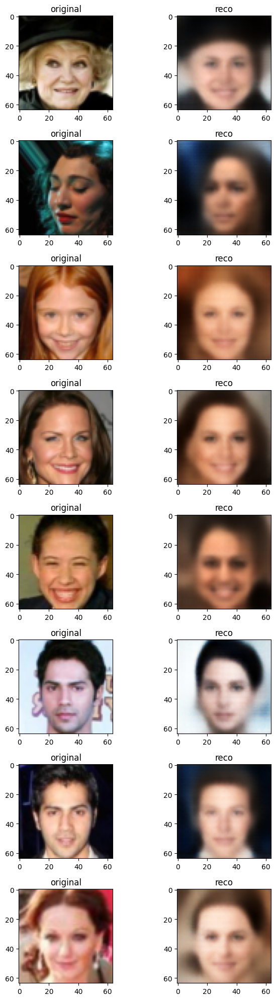

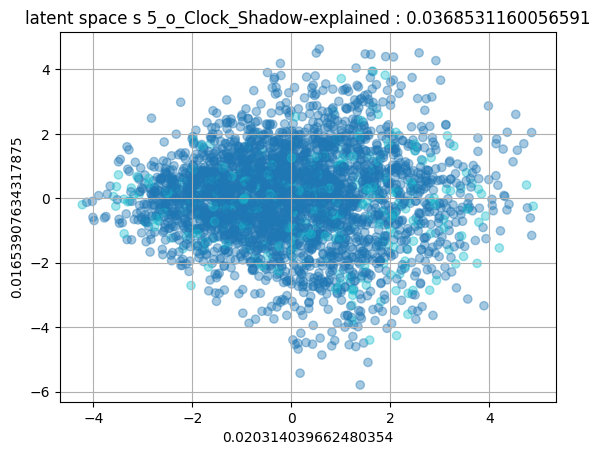

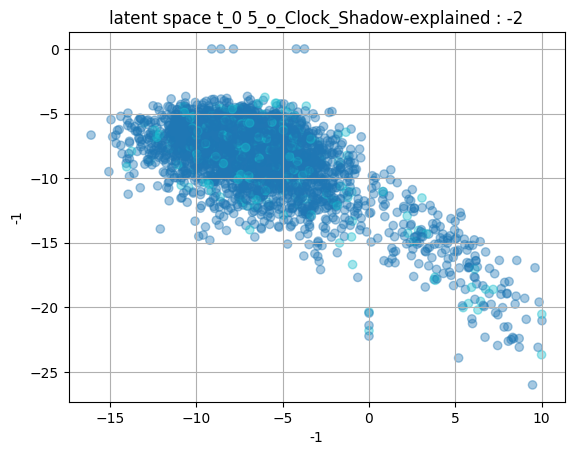

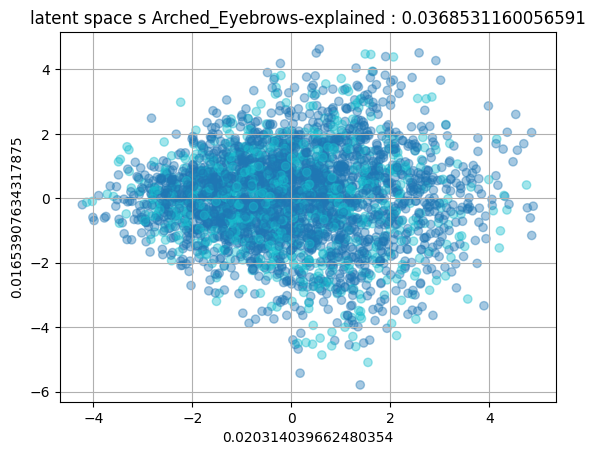

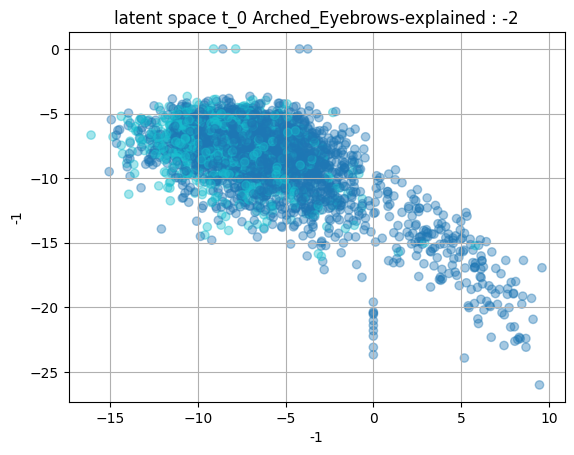

...

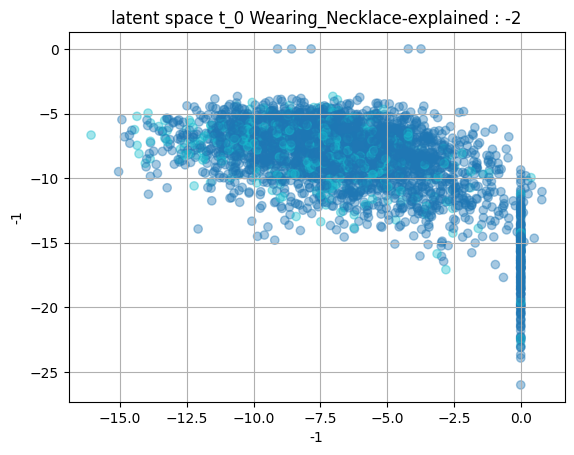

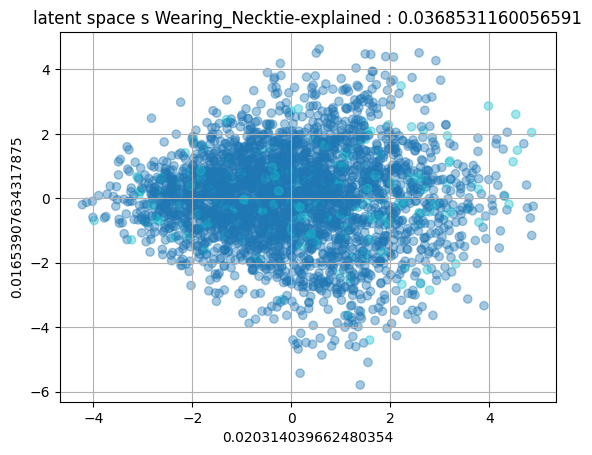

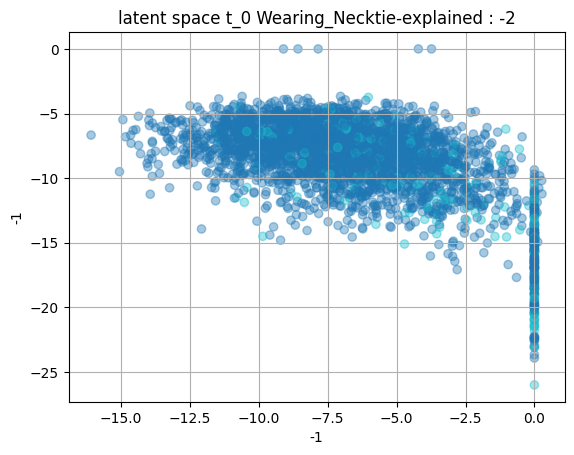

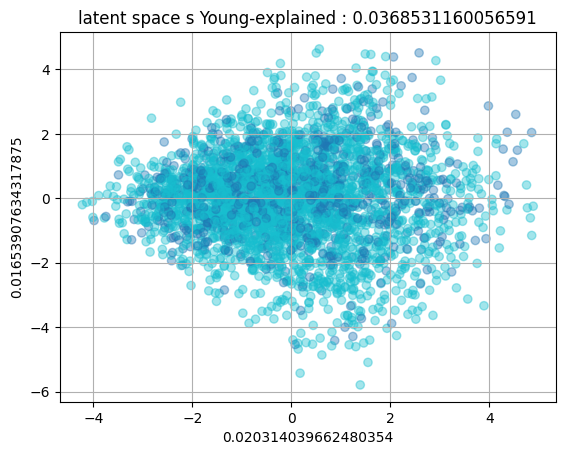

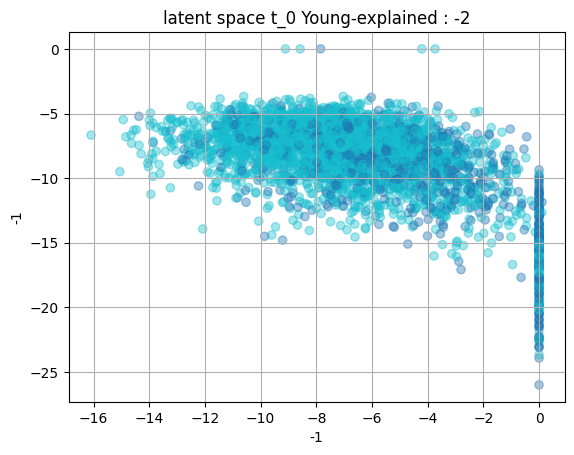

Epoch 0: 100%|██████████| 5087/5087 [03:45<00:00, 22.60it/s, v_num=88]

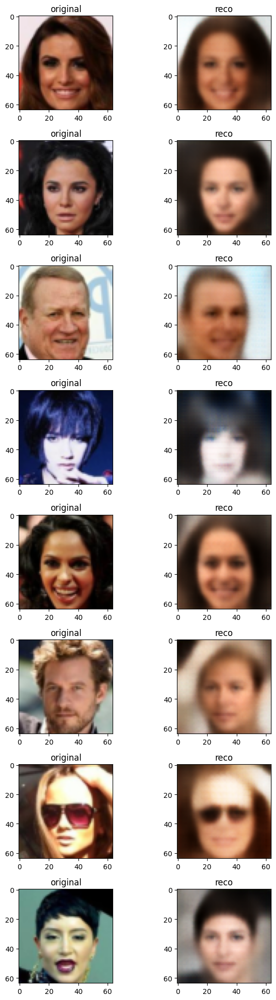

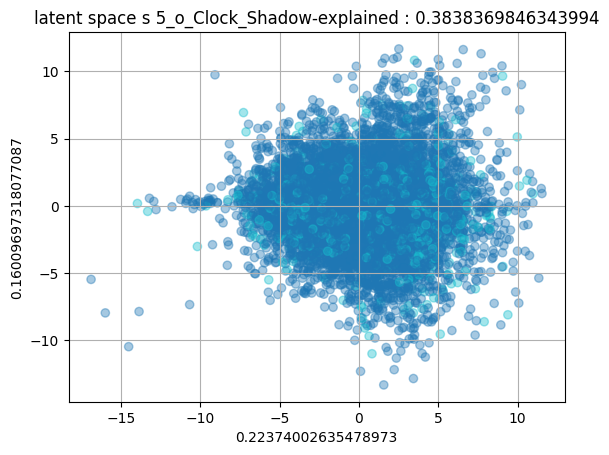

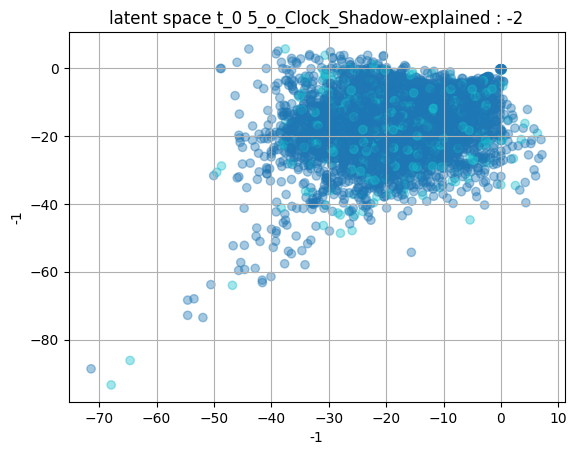

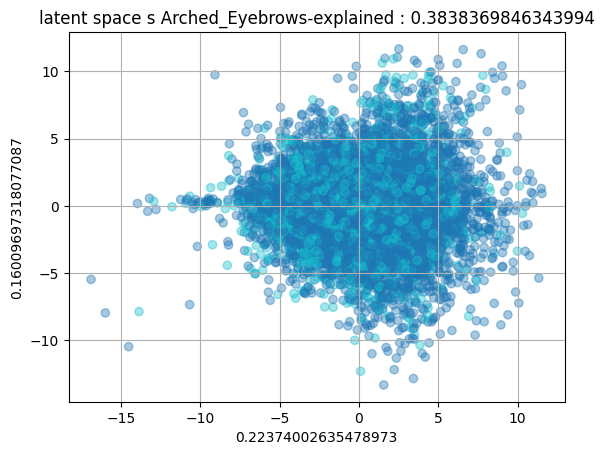

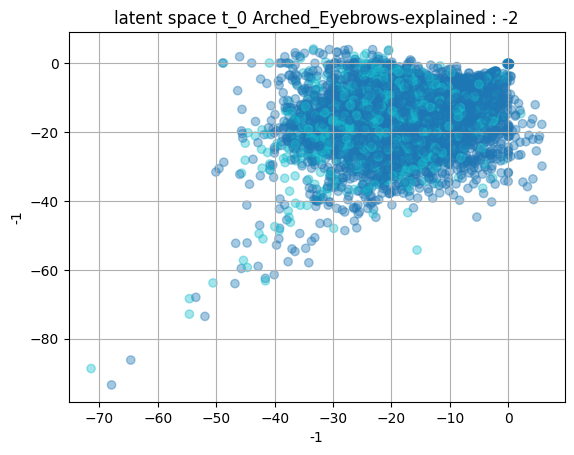

...

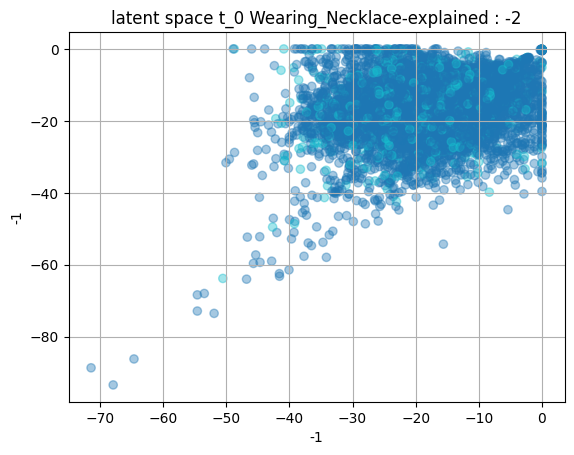

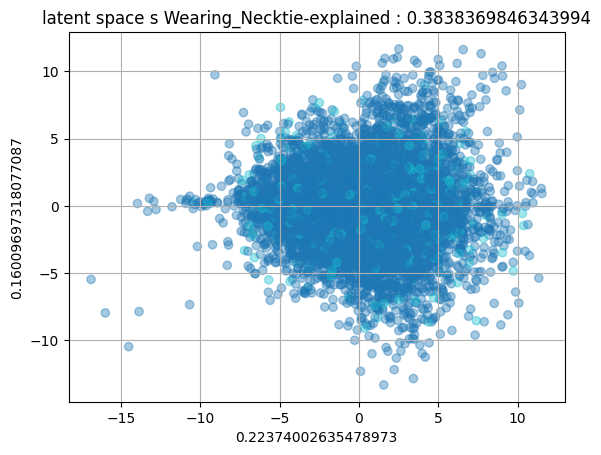

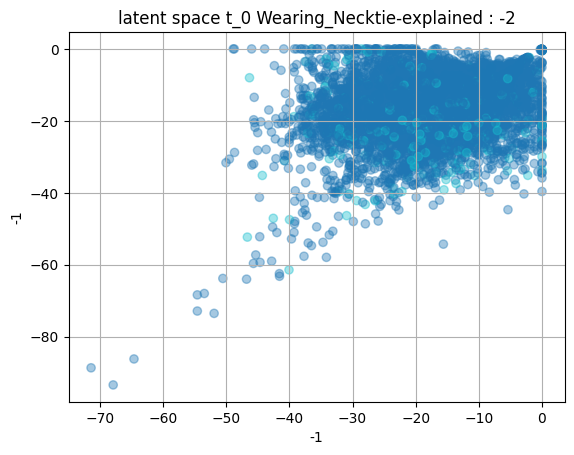

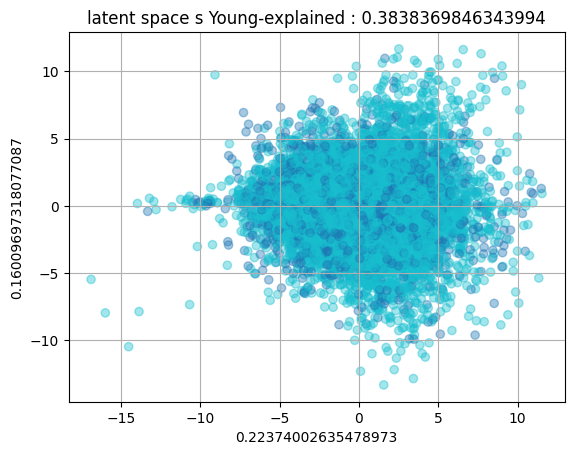

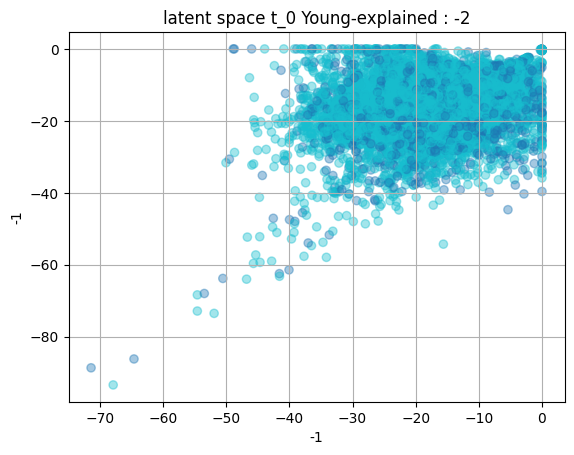

`Trainer.fit` stopped: `max_epochs=1` reached.


Epoch 0: 100%|██████████| 5087/5087 [04:31<00:00, 18.73it/s, v_num=88]


In [6]:
trainer.fit(xfactor, loader, val_loader)

In [8]:
xfactor.labels_val_buff[:, 15]==1

tensor([False, False, False,  ..., False,  True, False])

In [7]:
image.shape

NameError: name 'image' is not defined

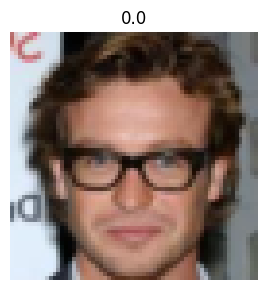

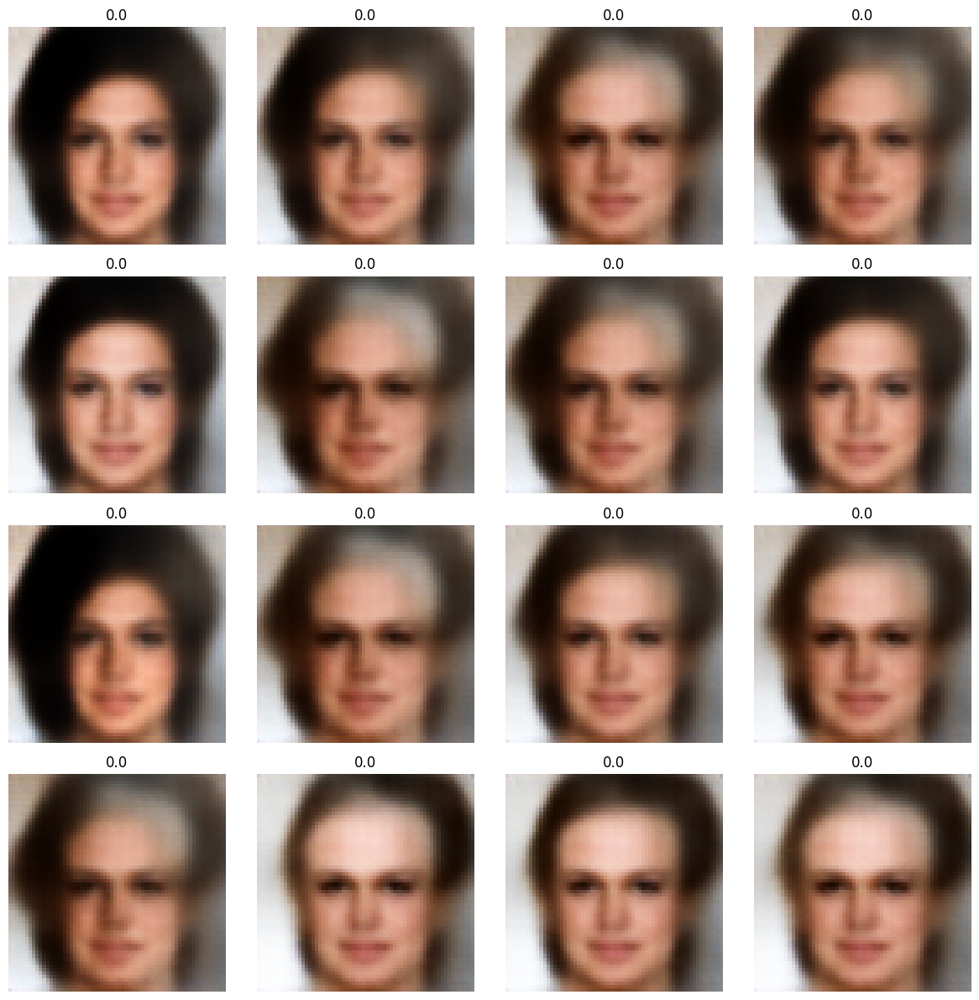

In [37]:
images, ref = xfactor.generate_by_factors(cond=15, img_ref=image.unsqueeze(0))
labels = torch.zeros(images.size(0))
labels_ref = torch.zeros(ref.size(0))
display((ref, labels_ref))
display((images, labels))

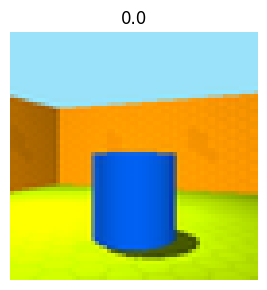

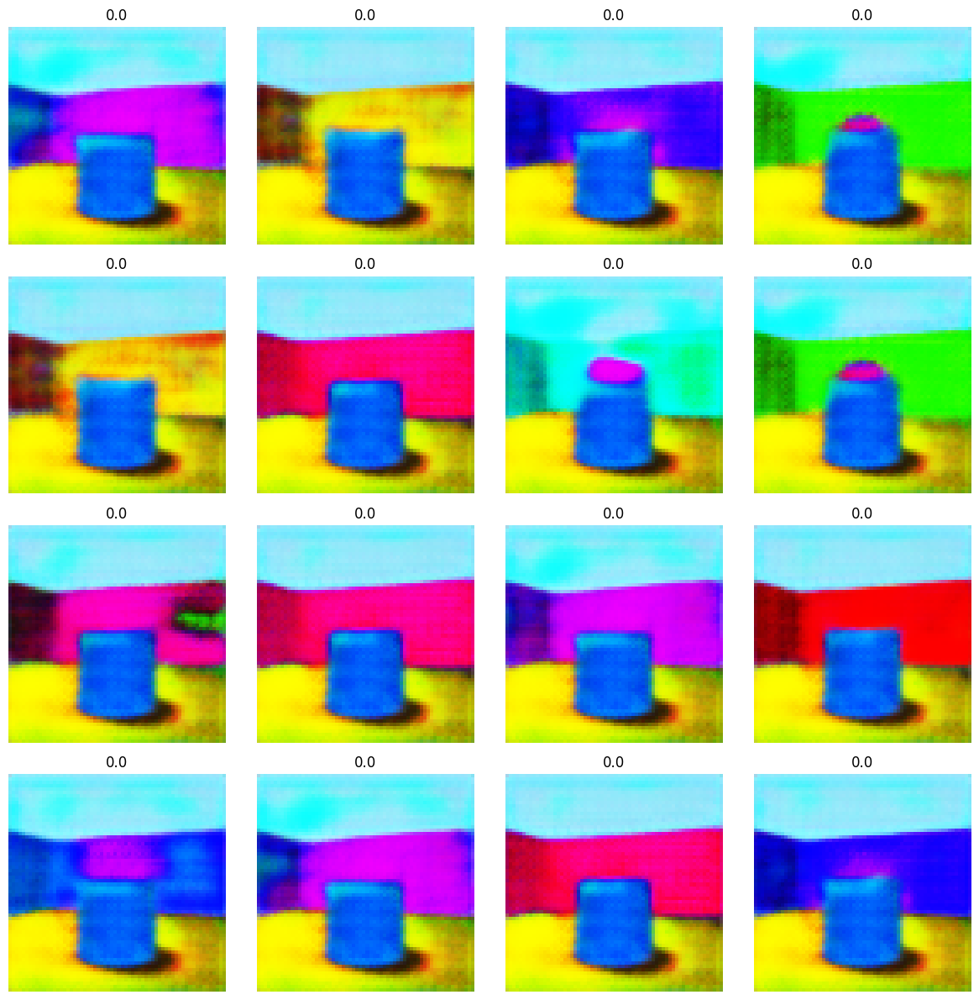

In [18]:
images, ref = xfactor.generate_by_factors(cond=1)
labels = torch.zeros(images.size(0))
labels_ref = torch.zeros(ref.size(0))
display((ref, labels_ref))
display((images, labels))

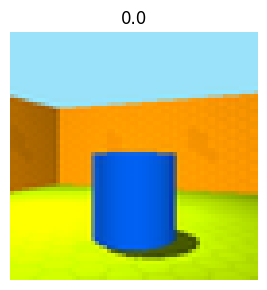

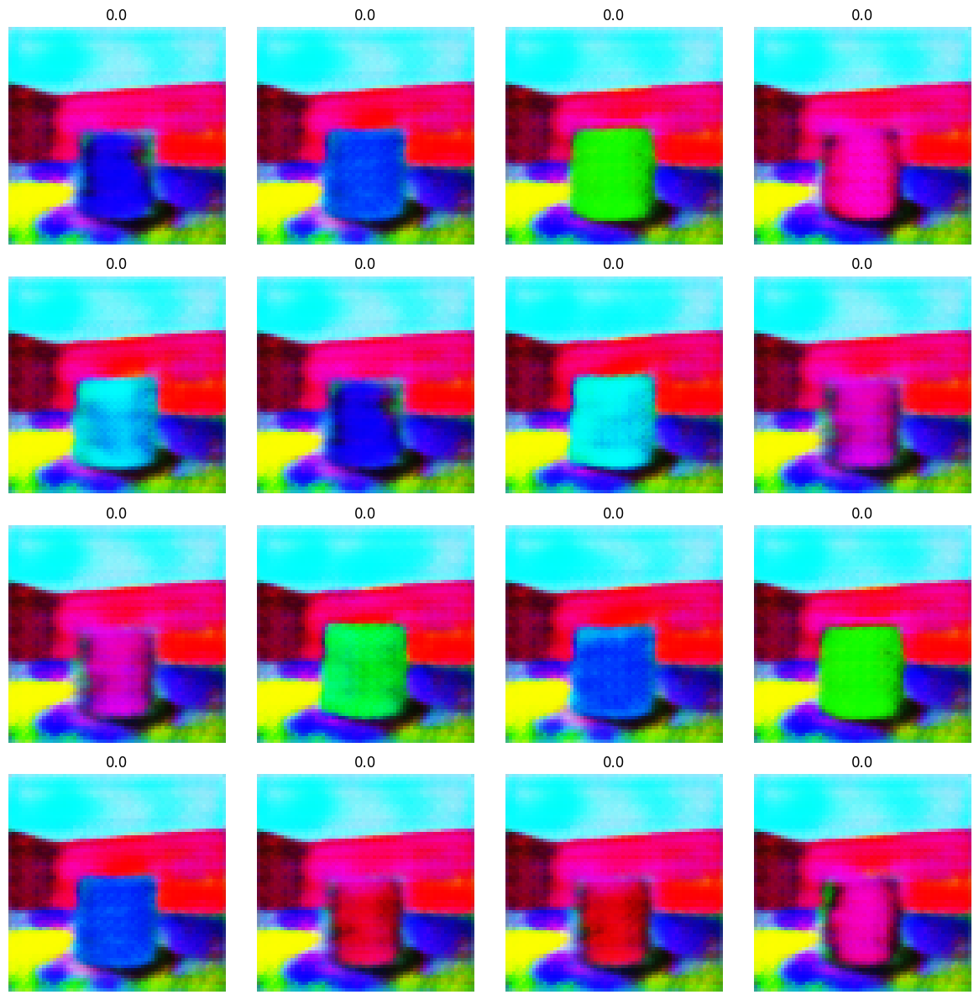

In [20]:
images, ref = xfactor.generate_by_factors(cond=2)
labels = torch.zeros(images.size(0))
labels_ref = torch.zeros(ref.size(0))
display((ref, labels_ref))
display((images, labels))

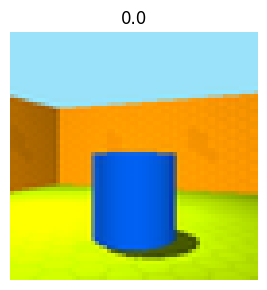

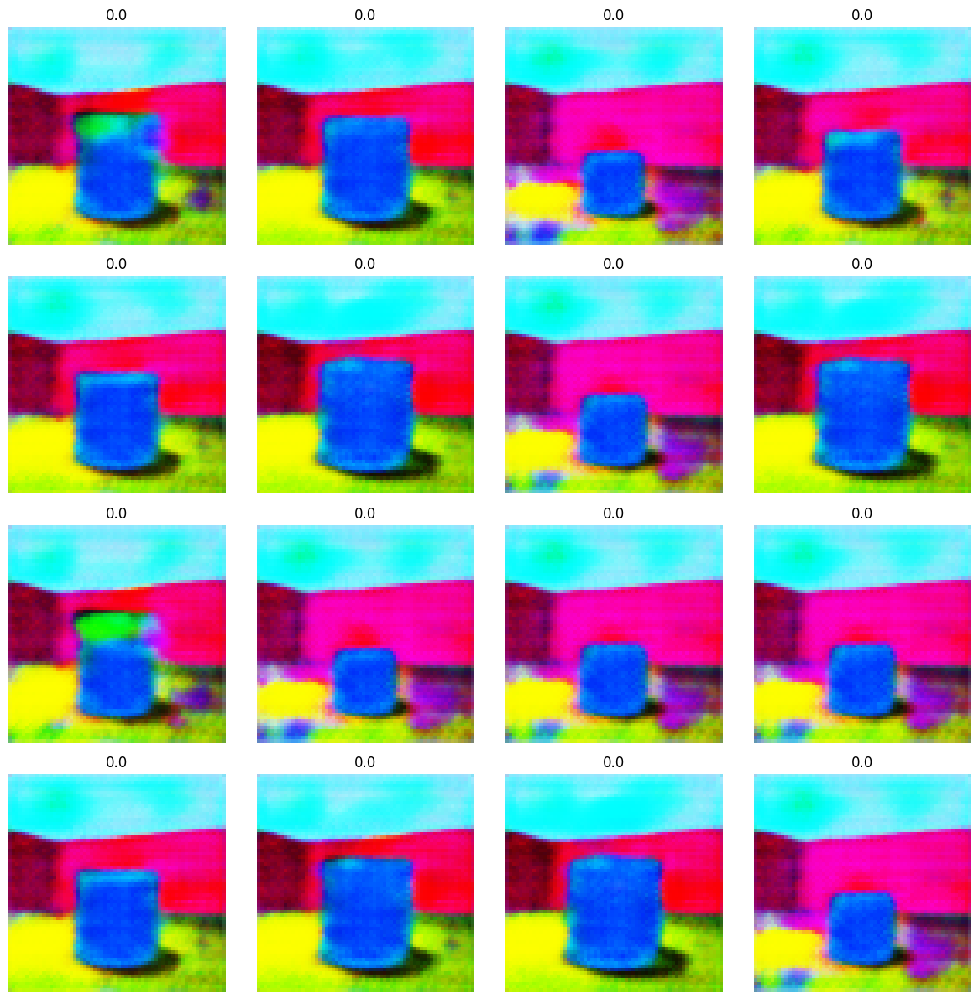

In [21]:
images, ref = xfactor.generate_by_factors(cond=3)
labels = torch.zeros(images.size(0))
labels_ref = torch.zeros(ref.size(0))
display((ref, labels_ref))
display((images, labels))

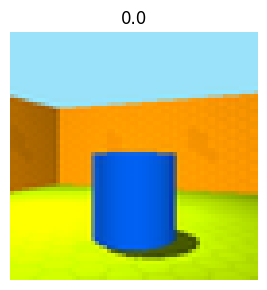

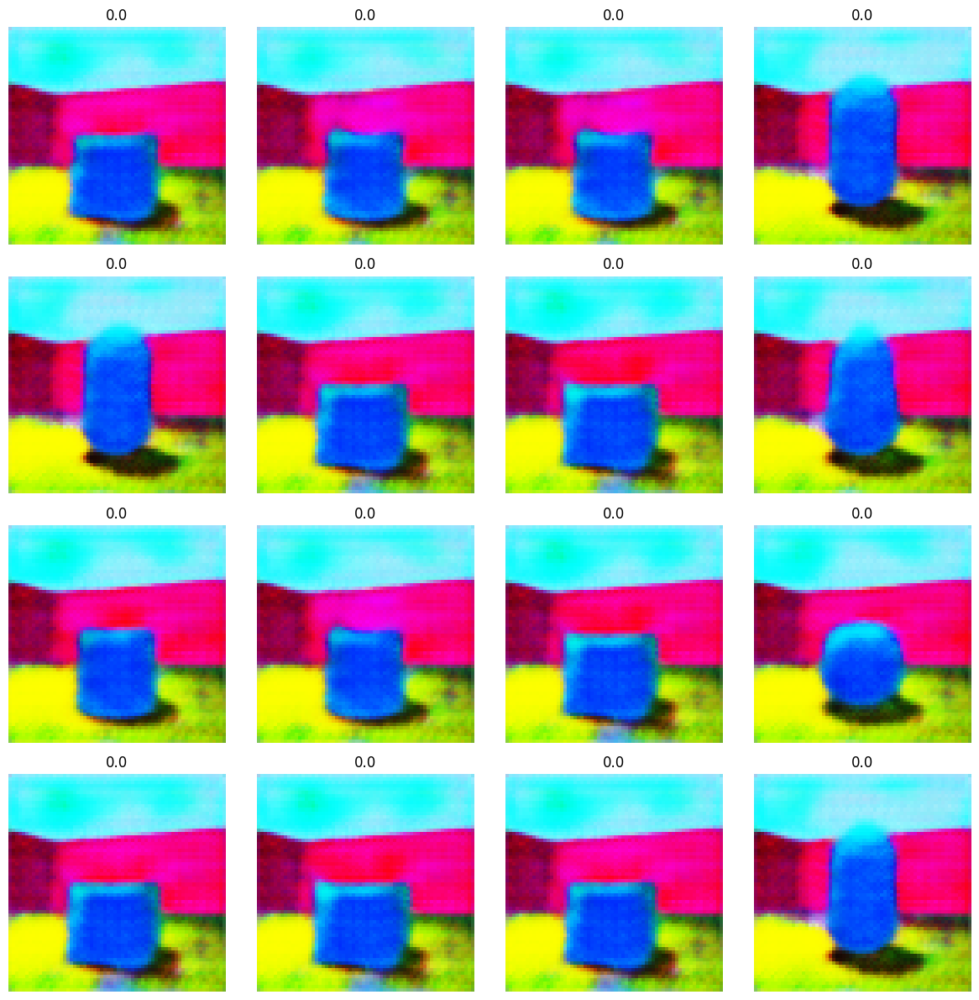

In [22]:
images, ref = xfactor.generate_by_factors(cond=4)
labels = torch.zeros(images.size(0))
labels_ref = torch.zeros(ref.size(0))
display((ref, labels_ref))
display((images, labels))

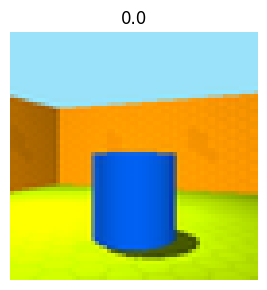

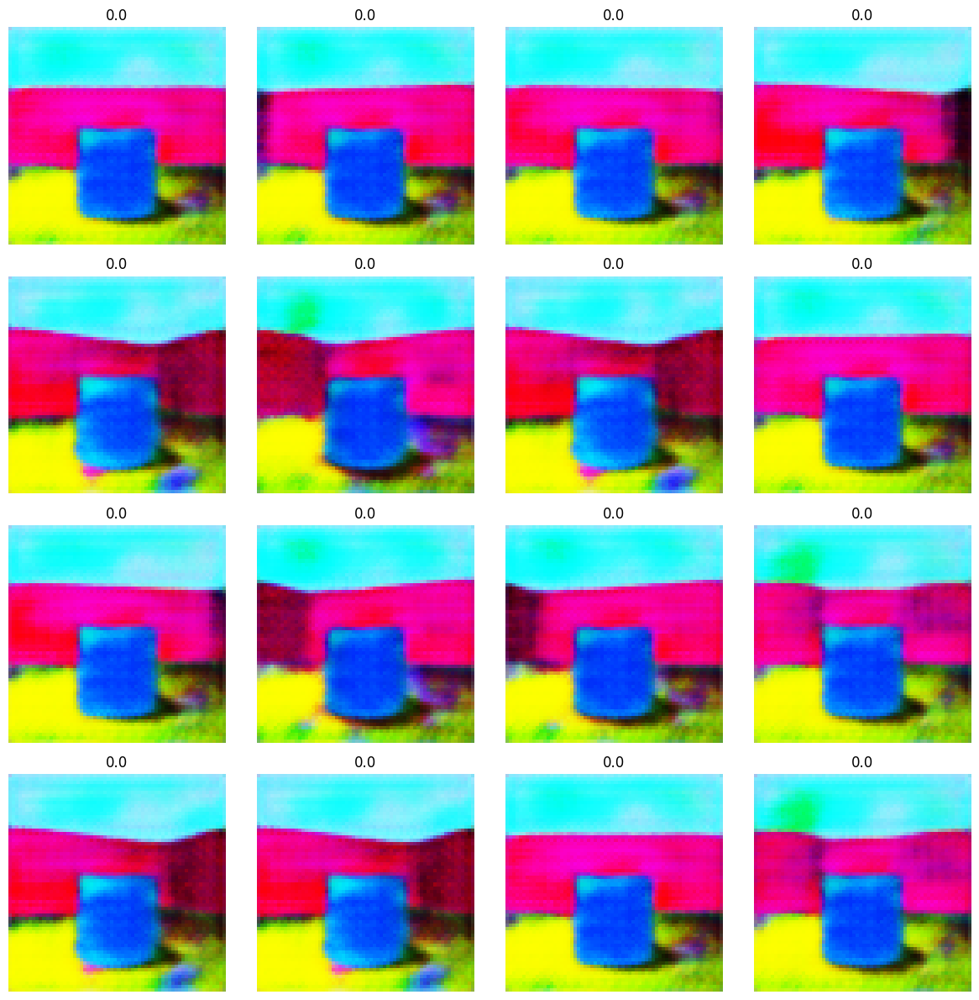

In [23]:
images, ref = xfactor.generate_by_factors(cond=5)
labels = torch.zeros(images.size(0))
labels_ref = torch.zeros(ref.size(0))
display((ref, labels_ref))
display((images, labels))

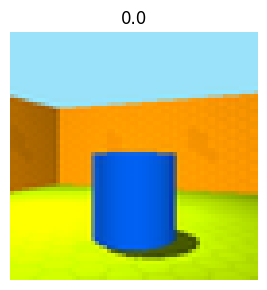

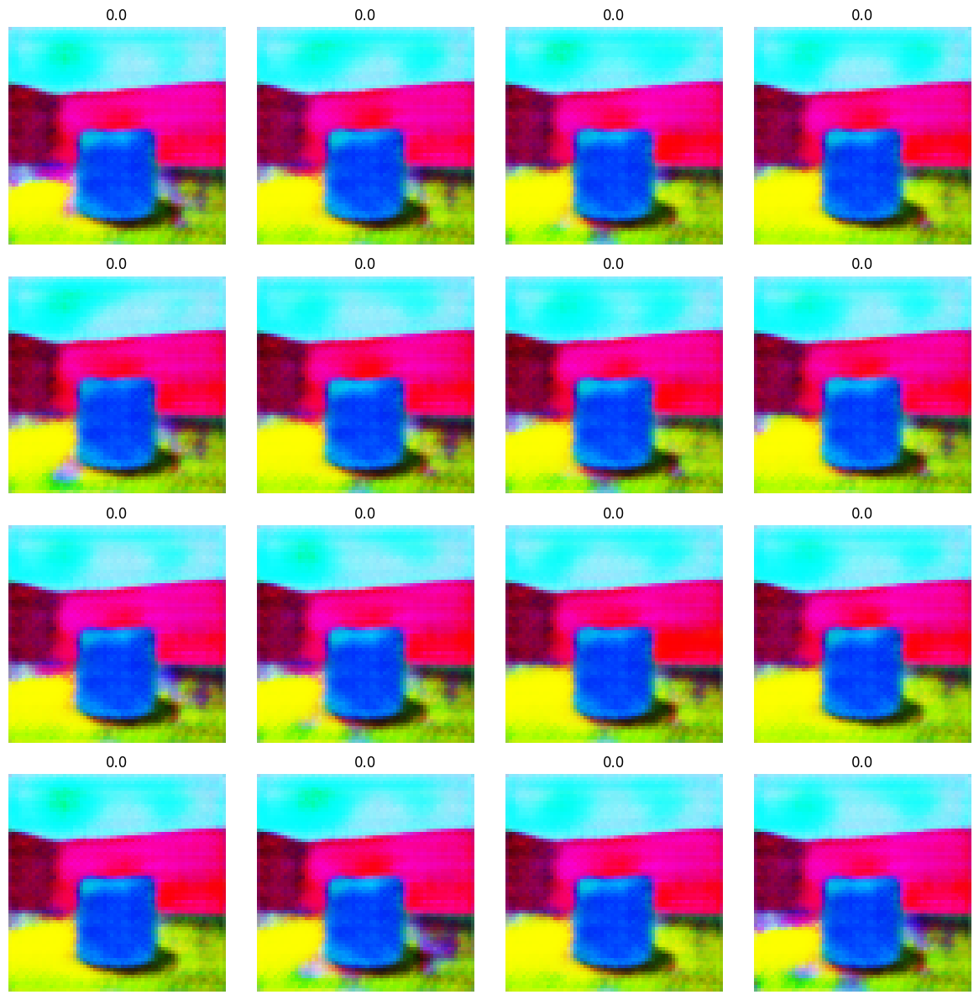

In [24]:
images, ref = xfactor.generate_cond(cond="s")
labels = torch.zeros(images.size(0))
labels_ref = torch.zeros(ref.size(0))
display((ref, labels_ref))
display((images, labels))